<a href="https://colab.research.google.com/github/PatricRc/introducao-a-sistemas-de-recomendacao-com-python/blob/master/YT_Phi_4_Multimodal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip -q install torch==2.5.1
!pip -q install flash_attn==2.7.4.post1
!pip -q install transformers==4.48.2
!pip -q install accelerate==1.3.0
!pip -q install soundfile==0.13.1
!pip -q install pillow==11.1.0
!pip -q install scipy==1.15.2
!pip -q install torchvision==0.21.0
!pip -q install backoff==2.2.1
!pip -q install peft==0.13.2
!pip -q install hf_transfer

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 83.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 79.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 10.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 39.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 18.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 90.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.0/6.0 MB 53.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.4/44.4 kB 2.1 MB/s eta 0:00:00
 

In [ ]:
os.environ ['HF_HUB_ENABLE_HF_TRANSFER'] = '1'

In [ ]:
import requests
import torch
import os
import io
from PIL import Image
import soundfile as sf
from transformers import AutoModelForCausalLM, AutoProcessor, GenerationConfig
from IPython.display import display, Markdown

In [ ]:
# Load the model and processor
model_path = "microsoft/Phi-4-multimodal-instruct"


model = AutoModelForCausalLM.from_pretrained(
    model_path,
    device_map="cuda",
    torch_dtype="auto",
    trust_remote_code=True,
    attn_implementation='flash_attention_2',
).cuda()

processor = AutoProcessor.from_pretrained(model_path, trust_remote_code=True)

processor_config.json:   0%|          | 0.00/121 [00:00<?, ?B/s]

processing_phi4mm.py:   0%|          | 0.00/32.8k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Phi-4-multimodal-instruct:
- processing_phi4mm.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.
/usr/local/lib/python3.11/dist-packages/transformers/models/auto/image_processing_auto.py:590: FutureWarning: The image_processor_class argument is deprecated and will be removed in v4.42. Please use `slow_image_processor_class`, or `fast_image_processor_class` instead
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.48, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


tokenizer_config.json:   0%|          | 0.00/3.25k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/3.91M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/15.5M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/249 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/473 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.63k [00:00<?, ?B/s]

configuration_phi4mm.py:   0%|          | 0.00/11.0k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Phi-4-multimodal-instruct:
- configuration_phi4mm.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_phi4mm.py:   0%|          | 0.00/116k [00:00<?, ?B/s]

vision_siglip_navit.py:   0%|          | 0.00/78.2k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Phi-4-multimodal-instruct:
- vision_siglip_navit.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


speech_conformer_encoder.py:   0%|          | 0.00/111k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Phi-4-multimodal-instruct:
- speech_conformer_encoder.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.
A new version of the following files was downloaded from https://huggingface.co/microsoft/Phi-4-multimodal-instruct:
- modeling_phi4mm.py
- vision_siglip_navit.py
- speech_conformer_encoder.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


model.safetensors.index.json:   0%|          | 0.00/240k [00:00<?, ?B/s]

model-00001-of-00003.safetensors:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

model-00002-of-00003.safetensors:   0%|          | 0.00/4.95G [00:00<?, ?B/s]

model-00003-of-00003.safetensors:   0%|          | 0.00/1.20G [00:00<?, ?B/s]

/root/.cache/huggingface/modules/transformers_modules/microsoft/Phi-4-multimodal-instruct/a11e830f953efbce02a57d3b672f84c5140e3f94/speech_conformer_encoder.py:2775: FutureWarning: Please specify CheckpointImpl.NO_REENTRANT as CheckpointImpl.REENTRANT will soon be removed as the default and eventually deprecated.
  lambda i: encoder_checkpoint_wrapper(


Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [ ]:
generation_config = GenerationConfig.from_pretrained(model_path)

In [ ]:
!nvidia-smi

Tue Mar  4 08:01:27 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   30C    P0             51W /  400W |   11835MiB /  40960MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

In [ ]:
import io

url = "https://assets-c4akfrf5b4d3f4b7.z01.azurefd.net/assets/2024/04/BMDataViz_661fb89f3845e.png"

response = requests.get(url, stream=True)
response.raise_for_status()
image = Image.open(io.BytesIO(response.content))

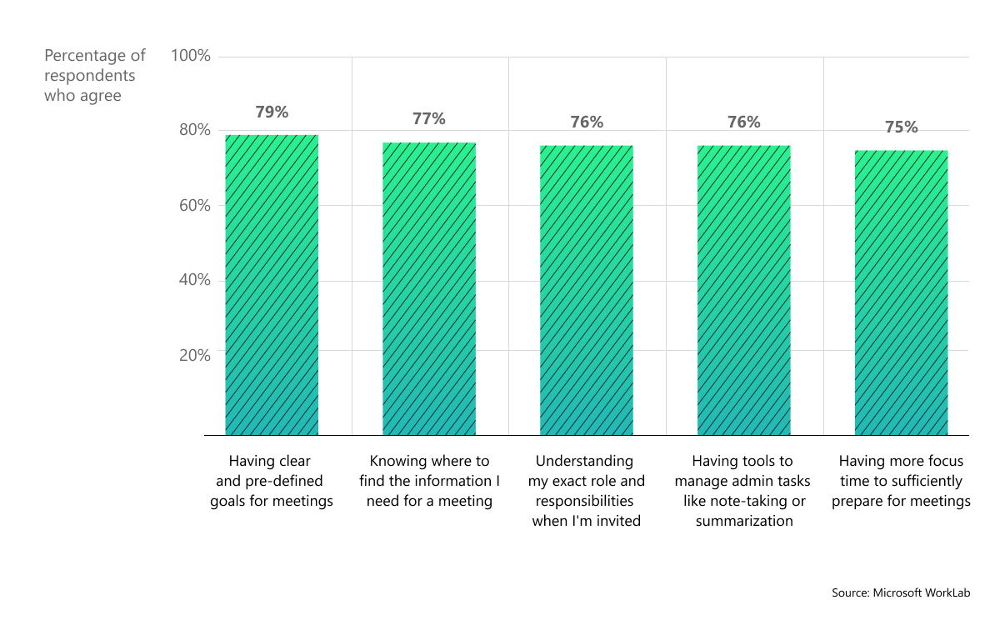

In [ ]:
image

In [ ]:
messages = [
    {"role": "user", "content": "<|image_1|>\nWhat is shown in this image?"},
    # {"role": "assistant", "content": "The chart displays the percentage of respondents who agree with various statements about their preparedness for meetings. It shows five categories: 'Having clear and pre-defined goals for meetings', 'Knowing where to find the information I need for a meeting', 'Understanding my exact role and responsibilities when I'm invited', 'Having tools to manage admin tasks like note-taking or summarization', and 'Having more focus time to sufficiently prepare for meetings'. Each category has an associated bar indicating the level of agreement, measured on a scale from 0% to 100%."},
    # {"role": "user", "content": "Provide insightful questions to spark discussion."}
]


In [ ]:
prompt = processor.tokenizer.apply_chat_template(messages, tokenize=False, add_generation_prompt=True)

inputs = processor(prompt, [image], return_tensors="pt").to("cuda:0")

In [ ]:
generation_args = {
    "max_new_tokens": 512,
    "do_sample": False,
    # "temperature": 0.0,

}

In [ ]:
generate_ids = model.generate(**inputs, eos_token_id=processor.tokenizer.eos_token_id, **generation_args)

# remove input tokens
generate_ids = generate_ids[:, inputs['input_ids'].shape[1]:]
response = processor.batch_decode(generate_ids, skip_special_tokens=True, clean_up_tokenization_spaces=False)[0]



The image is a bar chart showing the percentage of respondents who agree with various statements about meeting preparation. The statements are: 'Having clear and pre-defined goals for meetings', 'Knowing where to find the information I need for a meeting', 'Understanding my exact role and responsibilities when I’m invited', 'Having tools to manage admin tasks like note-taking or summarization', and 'Having more focus time to sufficiently prepare for meetings'. The percentages range from 75% to 79%. The source of the data is Microsoft WorkLab.


In [ ]:
Markdown(response)

The image is a bar chart showing the percentage of respondents who agree with various statements about meeting preparation. The statements are: 'Having clear and pre-defined goals for meetings', 'Knowing where to find the information I need for a meeting', 'Understanding my exact role and responsibilities when I’m invited', 'Having tools to manage admin tasks like note-taking or summarization', and 'Having more focus time to sufficiently prepare for meetings'. The percentages range from 75% to 79%. The source of the data is Microsoft WorkLab.

## Images

In [ ]:
def vqa_phi4(image, prompt):
    messages = [
        {"role": "user", "content": f"<|image_1|>\n{prompt}"},
    ]
    prompt = processor.tokenizer.apply_chat_template(messages, tokenize=False, add_generation_prompt=True)

    inputs = processor(text=prompt, images=[image], return_tensors="pt").to("cuda:0")

    generate_ids = model.generate(**inputs, eos_token_id=processor.tokenizer.eos_token_id, **generation_args)

    # remove input tokens
    generate_ids = generate_ids[:, inputs['input_ids'].shape[1]:]
    response = processor.batch_decode(generate_ids, skip_special_tokens=True, clean_up_tokenization_spaces=False)[0]

    print(response)
    return response


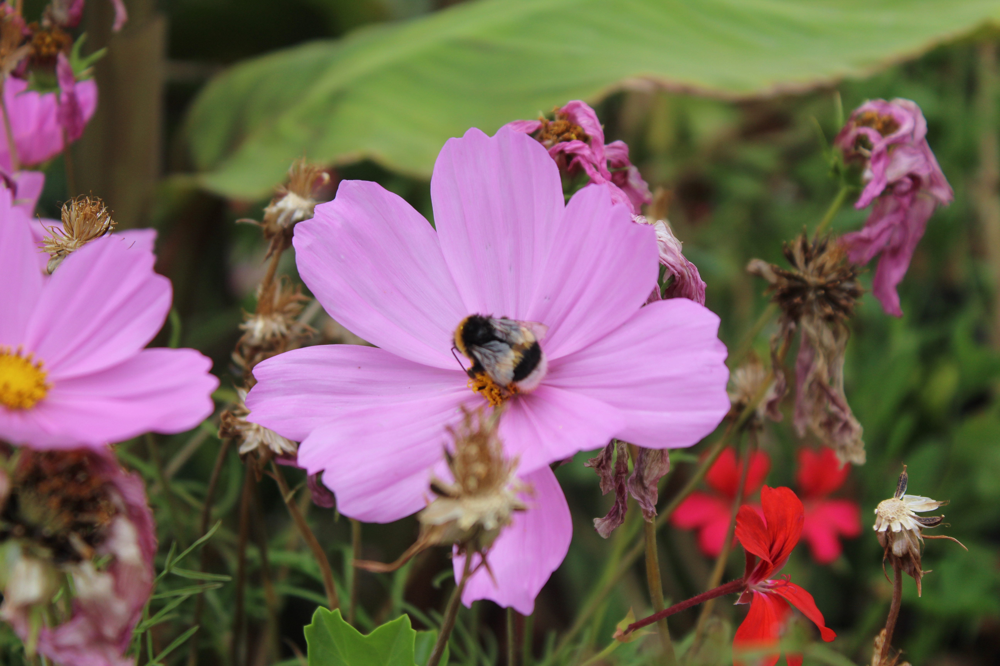

In [ ]:
img_url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/transformers/tasks/bee.JPG?download=true"

response = requests.get(img_url, stream=True)
response.raise_for_status()
image = Image.open(io.BytesIO(response.content))
image

In [ ]:
prompt = "What is shown in this image?"

vqa_phi4(image, prompt)

The image shows a close-up of a bee on a pink flower with a blurred background of other flowers and greenery.


'The image shows a close-up of a bee on a pink flower with a blurred background of other flowers and greenery.'

In [ ]:
prompt = "What kind of bee is in the image?"

vqa_phi4(image, prompt)

bumblebee


'bumblebee'

In [ ]:
prompt = "Apart from pink what bright color is another flower?"

vqa_phi4(image, prompt)

red


'red'

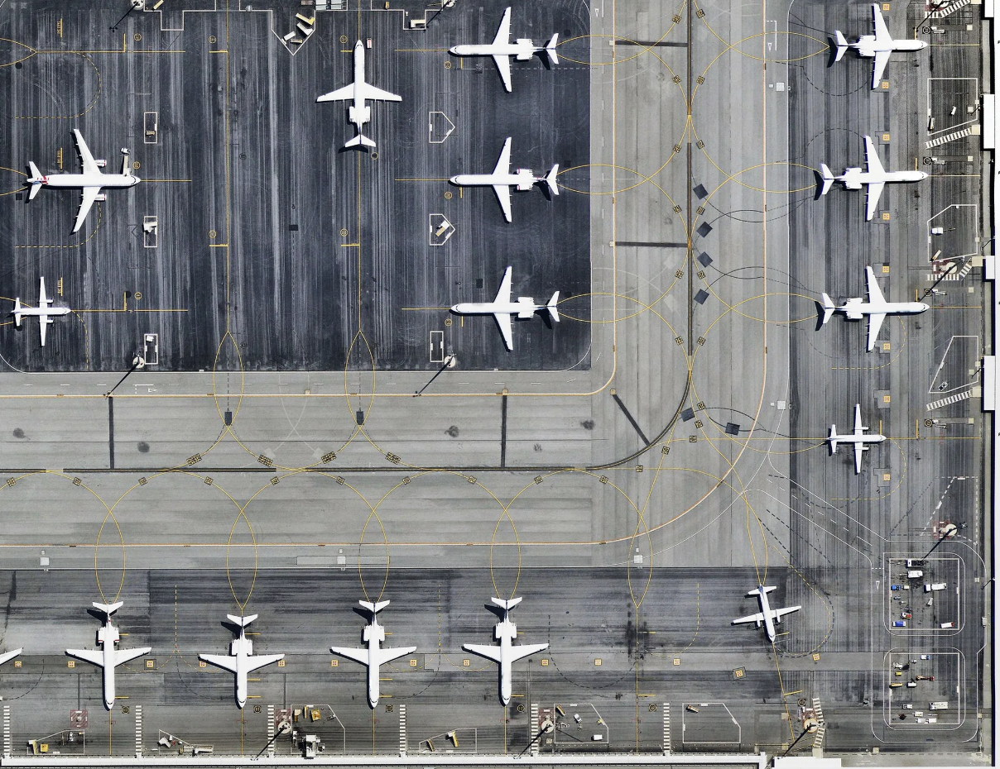

In [ ]:
img_path = "/content/planes_phi4.png"

image = Image.open(img_path).convert("RGB")
image

In [ ]:
prompt = "What is shown in this image?"

vqa_phi4(image, prompt)

The image depicts an airport with multiple airplanes parked on the tarmac.


'The image depicts an airport with multiple airplanes parked on the tarmac.'

In [ ]:
prompt = "How many planes are there?"

vqa_phi4(image, prompt)

10


'10'

In [ ]:
prompt = "Give me the bounding boxes for the planes"

vqa_phi4(image, prompt)

[0.0, 0.17, 0.24, 0.32], [0.25, 0.17, 0.44, 0.32], [0.49, 0.17, 0.64, 0.32], [0.75, 0.17, 0.88, 0.32], [0.0, 0.5, 0.24, 0.64], [0.25, 0.5, 0.44, 0.64], [0.49, 0.5, 0.64, 0.64], [0.75, 0.5, 0.88, 0.64], [0.0, 0.83, 0.24, 0.96], [0.25, 0.83, 0.44, 0.96], [0.49, 0.83, 0.64, 0.96], [0.75, 0.83, 0.88, 0.96], [0.0, 0.99, 0.24, 1.0], [0.25, 0.99, 0.44, 1.0], [0.49, 0.99, 0.64, 1.0], [0.75, 0.99, 0.88, 1.0]]


'[0.0, 0.17, 0.24, 0.32], [0.25, 0.17, 0.44, 0.32], [0.49, 0.17, 0.64, 0.32], [0.75, 0.17, 0.88, 0.32], [0.0, 0.5, 0.24, 0.64], [0.25, 0.5, 0.44, 0.64], [0.49, 0.5, 0.64, 0.64], [0.75, 0.5, 0.88, 0.64], [0.0, 0.83, 0.24, 0.96], [0.25, 0.83, 0.44, 0.96], [0.49, 0.83, 0.64, 0.96], [0.75, 0.83, 0.88, 0.96], [0.0, 0.99, 0.24, 1.0], [0.25, 0.99, 0.44, 1.0], [0.49, 0.99, 0.64, 1.0], [0.75, 0.99, 0.88, 1.0]]'

In [ ]:
prompt = "what airport is it?"

vqa_phi4(image, prompt)

unanswerable


'unanswerable'

## OCR

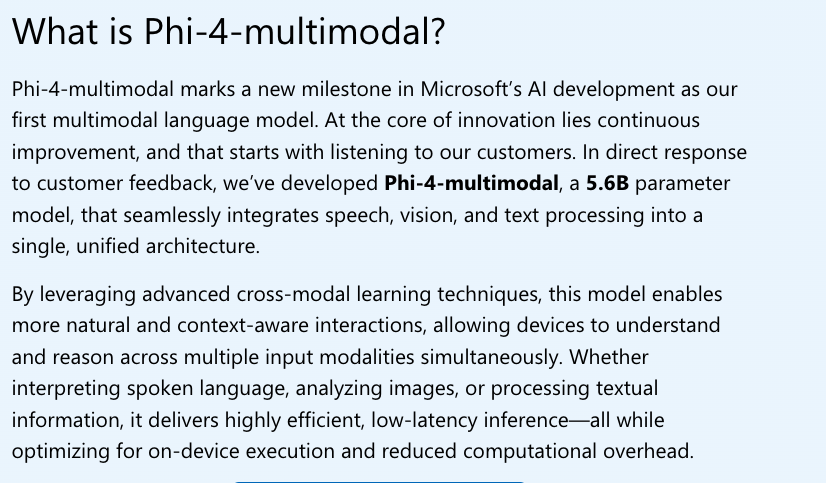

In [ ]:
img_path = "/content/blog_text.png"

image = Image.open(img_path).convert("RGB")
image

In [ ]:
prompt = "Please transcribe the text in this"

vqa_phi4(image, prompt)

What is Phi-4-multimodal?
Phi-4-multimodal marks a new milestone in Microsoft’s AI development as our first multimodal language model. At the core of innovation lies continuous improvement, and that starts with listening to our customers. In direct response to customer feedback, we’ve developed Phi-4-multimodal, a 5.6B parameter model, that seamlessly integrates speech, vision, and text processing into a single, unified architecture.
By leveraging advanced cross-modal learning techniques, this model enables more natural and context-aware interactions, allowing devices to understand and reason across multiple input modalities simultaneously. Whether interpreting spoken language, analyzing images, or processing textual information, it delivers highly efficient, low-latency inference—all while optimizing for on-device execution and reduced computational overhead.


'What is Phi-4-multimodal?\nPhi-4-multimodal marks a new milestone in Microsoft’s AI development as our first multimodal language model. At the core of innovation lies continuous improvement, and that starts with listening to our customers. In direct response to customer feedback, we’ve developed Phi-4-multimodal, a 5.6B parameter model, that seamlessly integrates speech, vision, and text processing into a single, unified architecture.\nBy leveraging advanced cross-modal learning techniques, this model enables more natural and context-aware interactions, allowing devices to understand and reason across multiple input modalities simultaneously. Whether interpreting spoken language, analyzing images, or processing textual information, it delivers highly efficient, low-latency inference—all while optimizing for on-device execution and reduced computational overhead.'

In [ ]:
prompt = "please summarize this text"

vqa_phi4(image, prompt)

The image contains a text titled 'What is Phi-4-multimodal?' which explains that Phi-4-multimodal is a new milestone in Microsoft's AI development. It is the first multimodal language model that integrates speech, vision, and text processing into a single architecture. The model is based on advanced cross-modal learning techniques, allowing devices to understand and reason across multiple input modalities simultaneously. It delivers highly efficient, low-latency inference and is optimized for on-device execution to reduce computational overhead.


"The image contains a text titled 'What is Phi-4-multimodal?' which explains that Phi-4-multimodal is a new milestone in Microsoft's AI development. It is the first multimodal language model that integrates speech, vision, and text processing into a single architecture. The model is based on advanced cross-modal learning techniques, allowing devices to understand and reason across multiple input modalities simultaneously. It delivers highly efficient, low-latency inference and is optimized for on-device execution to reduce computational overhead."

In [ ]:
prompt = "How big is the model?"

vqa_phi4(image, prompt)

5.6B


'5.6B'

## Audio

In [ ]:
audio_path = "/content/mark_zuckerberg_30_01.mp3"


# Read audio file using open()
with open(audio_path, "rb") as f:
    audio, samplerate = sf.read(io.BytesIO(f.read()))

from IPython.display import Audio
Audio(audio, rate=samplerate)


In [ ]:
def process_audio(prompt, audio, samplerate):
    messages = [
        {"role": "user", "content": f"<|audio_1|>\n{prompt}"},
    ]
    prompt = processor.tokenizer.apply_chat_template(messages, tokenize=False, add_generation_prompt=True)

    # Process with the model
    inputs = processor(text=prompt, audios=[(audio, samplerate)], return_tensors='pt').to('cuda:0')

    generate_ids = model.generate(**inputs, eos_token_id=processor.tokenizer.eos_token_id, **generation_args)

    # remove input tokens
    generate_ids = generate_ids[:, inputs['input_ids'].shape[1]:]
    response = processor.batch_decode(generate_ids, skip_special_tokens=True, clean_up_tokenization_spaces=False)[0]

    # print(response)
    return response

In [ ]:
prompt = "Transcribe the audio"
process_audio(prompt, audio, samplerate)


"i don't know the answer to that then you're then i'd be some some computer construct and not the person who created that meta company but that would truly be meta i mean it's not going to be four decades before we have photorealistic avatars like this so i think we're much closer to that well i think that's this is like the key question right because the the thing that's different about virtual and hopefully augmented reality compared to all other forms of of digital platforms before is this feeling of presencetranscribei mean it's not going to be four decades before we have photorealistic avatars like this so i think we're much closer to that well i think that's this is like the key question right because the the thing that's different about virtual and hopefully augmented reality compared to all other forms of of digital platforms before is this feeling of presencetranscribei mean it's not going to be four decades before we have photorealistic avatars like this so i think we're much

In [ ]:
Audio(audio, rate=samplerate)

In [ ]:
Audio(audio, rate=samplerate)

prompt = "Transcribe the audio to text, and then translate the audio to French. Use <sep> as a separator between the original transcript and the translation."
process_audio(prompt, audio, samplerate)

'"I don\'t know the answer to that, then I\'d be some some computer construct and not the person who created that meta company, but that would truly be meta. I mean, it\'s not gonna be four decades before we have photorealistic avatars like this, so I think we\'re much closer to that. Well, I think that\'s this is like the key question, right? Because the thing that\'s different about virtual and hopefully augmented reality compared to all other forms of digital platforms before is this feeling of presence." <sep> Je ne sais pas la réponse à cela, alors je serais une sorte de construction informatique et non la personne qui a créé cette entreprise de métas, mais ce serait vraiment une métaphore. Je veux dire, ce ne sera pas quatre décennies avant d\'avoir des avatars photoréalistes comme celui-ci, donc je pense que nous sommes beaucoup plus proches de cela. Je pense que c\'est la question clé, n\'est-ce pas ? Parce que la chose qui est différente dans la réalité virtuelle et, espérons-

## Just Text

In [ ]:
def just_text(prompt):
    messages = [
        {"role": "user", "content": f"{prompt}"},
    ]
    prompt = processor.tokenizer.apply_chat_template(messages, tokenize=False, add_generation_prompt=True)

    inputs = processor(text=prompt, return_tensors="pt").to("cuda:0")

    generate_ids = model.generate(**inputs, eos_token_id=processor.tokenizer.eos_token_id, **generation_args)

    # remove input tokens
    generate_ids = generate_ids[:, inputs['input_ids'].shape[1]:]
    response = processor.batch_decode(generate_ids, skip_special_tokens=True, clean_up_tokenization_spaces=False)[0]

    print(response)
    return response

In [ ]:
just_text("What is difference between Llama, Vicunas and Alpacas?")

Llamas, vicuñas, and alpacas are all South American camelids, but they have distinct differences in terms of their physical characteristics, habitats, and uses. Here are some key differences:

1. **Physical Characteristics:**
   - **Llamas:** Llamas are larger than alpacas and vicuñas, typically standing 4 to 5 feet tall at the shoulder. They have a more robust build and are often used for carrying loads. Llamas have a longer, more flowing coat that can be either long or short, and they have a distinctive black face with a white blaze.
   - **Vicuñas:** Vicuñas are the smallest of the three, standing about 2.5 to 3 feet tall. They have a very fine, silky coat that is the finest natural fiber in the world, making it highly valuable. Vicuñas have a slender build and a more delicate appearance compared to llamas and alpacas.
   - **Alpacas:** Alpacas are medium-sized, standing about 3 to 4 feet tall. They have a dense, woolly coat that comes in a variety of colors, including white, black,

'Llamas, vicuñas, and alpacas are all South American camelids, but they have distinct differences in terms of their physical characteristics, habitats, and uses. Here are some key differences:\n\n1. **Physical Characteristics:**\n   - **Llamas:** Llamas are larger than alpacas and vicuñas, typically standing 4 to 5 feet tall at the shoulder. They have a more robust build and are often used for carrying loads. Llamas have a longer, more flowing coat that can be either long or short, and they have a distinctive black face with a white blaze.\n   - **Vicuñas:** Vicuñas are the smallest of the three, standing about 2.5 to 3 feet tall. They have a very fine, silky coat that is the finest natural fiber in the world, making it highly valuable. Vicuñas have a slender build and a more delicate appearance compared to llamas and alpacas.\n   - **Alpacas:** Alpacas are medium-sized, standing about 3 to 4 feet tall. They have a dense, woolly coat that comes in a variety of colors, including white, 